In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
import plotly.express as px
import plotly.graph_objs as go
from sklearn.decomposition import PCA
from sklearn.metrics import jaccard_score
from sklearn.model_selection import ParameterGrid
from scipy.stats import ks_2samp

data2 = pd.read_csv('C:/Users/DELL/Desktop/OpenClass/Formation/Projet_005/SuiviClient2PourML.csv')


# K-means

In [2]:
# Sélection des colonnes RFM pour le clustering
data_rfm = data2[['Récence', 'Fréquence', 'Montant']]

# Initialisation du StandardScaler
scaler = StandardScaler()

# Standardisation des données
data_rfm_scaled = scaler.fit_transform(data_rfm)


In [3]:
# Imputation
imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
data_rfm_scaled_imputed = imputer.fit_transform(data_rfm_scaled)

# Assurez-vous d'utiliser la variable 'data_rfm_scaled_imputed' pour le KMeans
kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(data_rfm_scaled_imputed)

# Ajout des étiquettes de cluster au DataFrame original
data2['Cluster'] = kmeans.labels_


c:\Users\DELL\anaconda3\envs\2024\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


         customer_zip_code_prefix  nbr_commande  Total_achat     Récence  \
Cluster                                                                    
0                    34184.700114      1.000000   134.326502  132.618218   
1                    36319.775349      1.000000   133.328166  392.576694   
2                    34100.534979      2.112982   286.478103  228.610924   
3                    40381.296296      1.011960  1142.927338  246.562886   

         Fréquence      Montant  
Cluster                          
0         1.000000   134.326502  
1         1.000000   133.328166  
2         2.112982   286.478103  
3         1.011960  1142.927338  


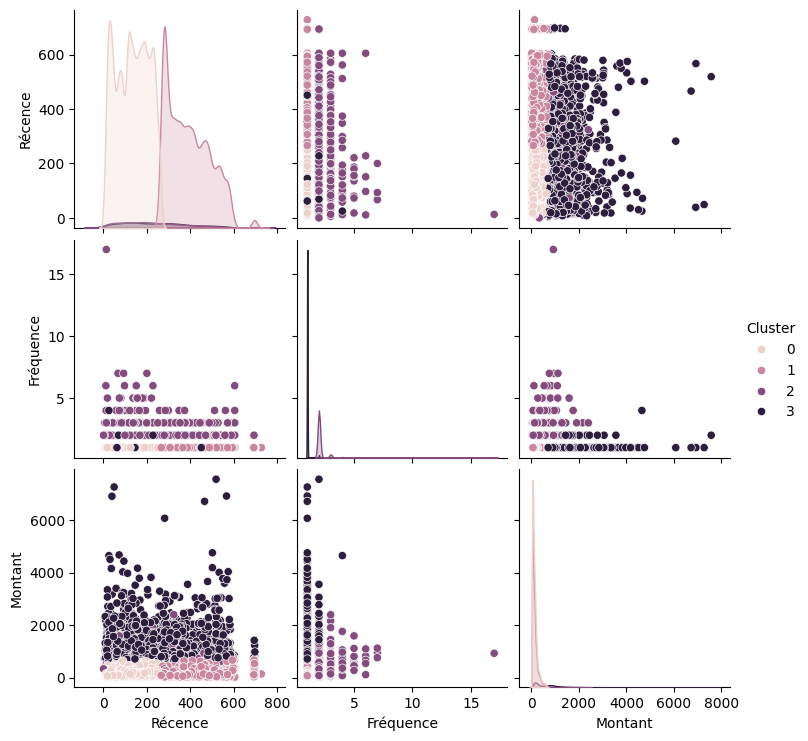

In [4]:
# Calcul des moyennes pour chaque cluster
cluster_summary = data2.select_dtypes(include=[np.number]).groupby('Cluster').mean()
print(cluster_summary)

# Pairplot avec coloration selon le cluster
sns.pairplot(data2, hue='Cluster', vars=['Récence', 'Fréquence', 'Montant'])
plt.show()


## Cluster

In [5]:
# Votre variable 'data_rfm_scaled_imputed' contient les données standardisées et imputées
# Votre DataFrame 'data2' contient maintenant une colonne 'Cluster' avec les labels de cluster
silhouette_avg = silhouette_score(data_rfm_scaled_imputed, data2['Cluster'])
print(f"Le score moyen de silhouette pour les clusters est : {silhouette_avg:.2f}")


Le score moyen de silhouette pour les clusters est : 0.49


In [6]:
# Réduction de la dimensionnalité en 2 composantes pour une visualisation 2D
pca_2d = PCA(n_components=2)
pca_result_2d = pca_2d.fit_transform(data_rfm_scaled_imputed)

# Réduction de la dimensionnalité en 3 composantes pour une visualisation 3D
pca_3d = PCA(n_components=3)
pca_result_3d = pca_3d.fit_transform(data_rfm_scaled_imputed)


In [7]:
# Visualisation 2D
fig_2d = px.scatter(
    x=pca_result_2d[:, 0], y=pca_result_2d[:, 1],
    color=data2['Cluster'].astype(str),  # Assurez-vous que les étiquettes sont converties en chaînes de caractères pour la légende
    labels={'0': 'PC 1', '1': 'PC 2'}
)
fig_2d.update_layout(title="Visualisation 2D des clusters avec PCA")
fig_2d.show()

# Visualisation 3D
fig_3d = px.scatter_3d(
    x=pca_result_3d[:, 0], y=pca_result_3d[:, 1], z=pca_result_3d[:, 2],
    color=data2['Cluster'].astype(str),
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig_3d.update_layout(title="Visualisation 3D des clusters avec PCA")
fig_3d.show()


In [8]:
# Nombre de clusters
n_clusters = 4

# Exécuter KMeans avec différentes initialisations
labels = []
for i in range(20):
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++', n_init=1, random_state=i)
    kmeans.fit(data_rfm_scaled_imputed)
    labels.append(kmeans.labels_)

# Évaluer la stabilité des clusters à l'initialisation
# Calculer la similarité de Jaccard pour chaque paire unique d'exécutions
jaccard_scores = []
for i in range(len(labels)):
    for j in range(i+1, len(labels)):
        score = jaccard_score(labels[i], labels[j], average='macro')
        jaccard_scores.append(score)

# Afficher la moyenne des scores de Jaccard
print(f'Moyenne des scores de Jaccard pour la stabilité des clusters : {np.mean(jaccard_scores)}')


Moyenne des scores de Jaccard pour la stabilité des clusters : 0.23914803815034738


In [9]:
# Définition de la grille de paramètres pour KMeans
param_grid = {'n_clusters': range(3, 5),  # par exemple de 2 à 9 clusters
              'init': ['k-means++', 'random'],
              'n_init': [10, 15, 20],
              'max_iter': [300, 600, 900]}

# Initialisation de la meilleure métrique et du meilleur modèle
best_score = -1
best_model = None
best_params = {}

# Grid search manuel
for params in ParameterGrid(param_grid):
    kmeans = KMeans(**params)
    kmeans.fit(data_rfm_scaled_imputed)
    # Calcul du score de silhouette
    score = silhouette_score(data_rfm_scaled_imputed, kmeans.labels_)

    # Mise à jour du meilleur score et des meilleurs paramètres
    if score > best_score:
        best_score = score
        best_model = kmeans
        best_params = params

# Affichage des meilleurs paramètres et du meilleur score
print(f'Meilleurs paramètres : {best_params}')
print(f'Meilleur score de silhouette : {best_score}')


In [ ]:

def simuler_clustering(data2, colonne_date, nombre_de_periodes, n_clusters):
    # Convertir la colonne de date en datetime et trier le DataFrame par cette colonne
    data2[colonne_date] = pd.to_datetime(data2[colonne_date])
    data2 = data2.sort_values(by=colonne_date)

    # Trouver la date la plus récente dans le dataset
    date_max = data2[colonne_date].max()

    # Définir la durée d'une période en jours
    duree_periode = (date_max - data2[colonne_date].min()) / nombre_de_periodes

    # Initialiser la liste pour stocker les résultats de clustering
    resultats_clustering = []

    # Créer les périodes et effectuer le clustering pour chacune
    for i in range(nombre_de_periodes):
        # Calculer les limites de la période actuelle
        fin_periode = date_max - i * duree_periode
        debut_periode = date_max - (i + 1) * duree_periode

        # Sélectionner les données pour la période actuelle
        donnees_periode = data2[(data2[colonne_date] > debut_periode) & (data2[colonne_date] <= fin_periode)]

        # Imputer les valeurs manquantes
        imputer = SimpleImputer(strategy='mean')
        donnees_periode = donnees_periode.copy()  # Faire une copie pour éviter les avertissements
        donnees_periode[rfm_columns] = imputer.fit_transform(donnees_periode[rfm_columns])

        # Appliquer le clustering K-Means si assez de données
        if len(donnees_periode) >= n_clusters:
            kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
            donnees_periode['Cluster'] = kmeans.fit_predict(donnees_periode[rfm_columns])

            # Ajouter les résultats au tableau
            resultats_clustering.append({
                'debut_periode': debut_periode,
                'fin_periode': fin_periode,
                'donnees': donnees_periode,
                'etiquettes': kmeans.labels_
            })

    return resultats_clustering

# Vos colonnes RFM pourraient avoir des noms différents
rfm_columns = ['Récence', 'Fréquence', 'Montant']


In [ ]:
resultats_clustering = simuler_clustering(data2, 'Date_Derniere_Commande', 4, 4)  # vos_donnees, 'Date_Dernière_Commande', nombre_de_periodes, nombre_de_clusters)

# Palette de couleurs personnalisée
couleurs_clusters = {'0': 'red', '1': 'blue', '2': 'green', '3': 'orange'}

# Boucle sur les résultats de clustering
for i, resultat in enumerate(resultats_clustering):
    donnees_periode = resultat['donnees'].copy()  # Utiliser .copy() pour éviter SettingWithCopyWarning
    clusters = resultat['etiquettes']

    # Imputez les valeurs manquantes
    imputer = SimpleImputer(strategy='mean')
    donnees_periode[rfm_columns] = imputer.fit_transform(donnees_periode[rfm_columns])

    # ACP pour réduction à 2 dimensions
    pca_2d = PCA(n_components=2)
    pca_result_2d = pca_2d.fit_transform(donnees_periode[rfm_columns])

    # ACP pour réduction à 3 dimensions
    pca_3d = PCA(n_components=3)
    pca_result_3d = pca_3d.fit_transform(donnees_periode[rfm_columns])

    # Conversion des étiquettes de cluster en chaînes de caractères pour la couleur
    donnees_periode['Cluster'] = pd.Categorical(clusters).astype(str)

    # Visualisation 2D
    fig_2d = px.scatter(
        x=pca_result_2d[:, 0], y=pca_result_2d[:, 1],
        color=donnees_periode['Cluster'],
        color_discrete_map=couleurs_clusters,  # Utilisation de la palette personnalisée
        title=f"Visualisation 2D des clusters avec PCA pour la période {i + 1}"
    )
    fig_2d.show()

    # Visualisation 3D
    fig_3d = px.scatter_3d(
        x=pca_result_3d[:, 0], y=pca_result_3d[:, 1], z=pca_result_3d[:, 2],
        color=donnees_periode['Cluster'],
        color_discrete_map=couleurs_clusters,  # Utilisation de la palette personnalisée
        title=f"Visualisation 3D des clusters avec PCA pour la période {i + 1}"
    )
    fig_3d.show()


In [ ]:
# Palette de couleurs personnalisée
couleurs_clusters = {'0': 'red', '1': 'blue', '2': 'green', '3': 'orange'}

data_with_periods = pd.concat([r['donnees'] for r in resultats_clustering], ignore_index=True)

# Conversion de 'Date_Derniere_Commande' en période (mois) et en chaîne de caractères pour Plotly
data2['periode'] = pd.to_datetime(data2['Date_Derniere_Commande']).dt.to_period('M').astype(str)

# Calcul de la taille de chaque cluster par période
cluster_sizes = data2.groupby(['periode', 'Cluster']).size().reset_index(name='taille')

# Pivoter les données pour obtenir une colonne par cluster
pivot_table = cluster_sizes.pivot(index='periode', columns='Cluster', values='taille').fillna(0)

# Réinitialisation de l'index pour utiliser 'periode' comme une colonne normale
pivot_table = pivot_table.reset_index()

# Préparation des données pour le graphique linéaire
# Plotly a besoin de les avoir en format long
data_for_plot = pd.melt(pivot_table, id_vars='periode', var_name='Cluster', value_name='Taille')

# Création du graphique linéaire avec Plotly
fig = px.line(data_for_plot, x='periode', y='Taille', color='Cluster', color_discrete_map=couleurs_clusters,
              title='Évolution de la taille des clusters au fil du temps',
              labels={'periode': 'Période', 'Taille': 'Taille du Cluster', 'Cluster': 'Cluster'})

# Affichage du graphique
fig.show()



In [ ]:
# Assurez-vous que 'Date_Derniere_Commande' est convertie en datetime si ce n'est pas déjà fait
data2['Date_Derniere_Commande'] = pd.to_datetime(data2['Date_Derniere_Commande'])

# Créez la colonne 'periode'
data2['periode'] = data2['Date_Derniere_Commande'].dt.to_period("M").astype(str)

# Vérifiez que la colonne 'periode' existe
print(data2['periode'].head())

# Sélectionnez les données numériques et la colonne 'periode'
data2_numeric_with_period = data2.select_dtypes(include=[np.number])
data2_numeric_with_period['periode'] = data2['periode']

# Vérifiez que 'periode' est dans le nouveau DataFrame
print(data2_numeric_with_period.head())

# Maintenant, effectuez le groupement
centroids = data2_numeric_with_period.groupby(['periode', 'Cluster']).mean().reset_index()
print(centroids.head())


0    2018-05
1    2018-05
2    2017-03
3    2017-10
4    2017-11
Name: periode, dtype: object
   customer_zip_code_prefix  nbr_commande  Total_achat  Récence  Fréquence  \
0                      7787             1       141.90      115          1   
1                      6053             1        27.19      118          1   
2                     88115             1        86.22      541          1   
3                     66812             1        43.62      325          1   
4                     18040             1       196.89      292          1   

   Montant  Cluster  periode  
0   141.90        0  2018-05  
1    27.19        0  2018-05  
2    86.22        1  2017-03  
3    43.62        1  2017-10  
4   196.89        1  2017-11  
   periode  Cluster  customer_zip_code_prefix  nbr_commande  Total_achat  \
0  2016-09        1              69309.000000           1.0   136.230000   
1  2016-10        1              39108.114286           1.0   158.042393   
2  2016-10        2    

In [ ]:
# Préparation des données pour le graphique linéaire - prenons la moyenne de la 'Récence' pour cet exemple
centroids = centroids.pivot(index='periode', columns='Cluster', values='Récence').fillna(0)

# Réinitialisation de l'index pour utiliser 'periode' comme une colonne normale
centroids = centroids.reset_index()

# Conversion des périodes en chaîne pour la compatibilité avec Plotly
centroids['periode'] = centroids['periode'].astype(str)

# Préparation des données pour Plotly - format long
data_for_plot = pd.melt(centroids, id_vars='periode', var_name='Cluster', value_name='Centroïdité_Récence')

# Création du graphique linéaire avec Plotly
fig = px.line(data_for_plot, x='periode', y='Centroïdité_Récence', color='Cluster', color_discrete_map=couleurs_clusters,
              title='Évolution de la centroïdité des clusters pour la Récence au fil du temps',
              labels={'periode': 'Période', 'Centroïdité_Récence': 'Centroïdité de la Récence', 'Cluster': 'Cluster'})

# Affichage du graphique
fig.show()


In [ ]:
# Calcul des centroïdes pour chaque cluster et chaque période
centroids = data2_numeric_with_period.groupby(['periode', 'Cluster']).mean().reset_index()

# Conversion des périodes en chaînes pour la compatibilité avec Plotly
centroids['periode'] = centroids['periode'].astype(str)

# Créer une figure Plotly
fig = go.Figure()

# Palette de couleurs pour les clusters
colors = {
    0: ['red', 'darkred', 'lightcoral'],
    1: ['blue', 'darkblue', 'lightblue'],
    2: ['green', 'darkgreen', 'lightgreen'],
    3: ['purple', 'indigo', 'plum']
}

# Attributs RFM à tracer
rfm_attributes = ['Récence', 'Fréquence', 'Montant']

# Ajouter les traces pour chaque centroïde de chaque cluster
for cluster in centroids['Cluster'].unique():
    cluster_data = centroids[centroids['Cluster'] == cluster]
    for i, attr in enumerate(rfm_attributes):
        fig.add_trace(go.Scatter(
            x=cluster_data['periode'],
            y=cluster_data[attr],
            mode='lines+markers',
            name=f'Cluster {cluster} - {attr}',
            line=dict(color=colors[cluster][i]),
            showlegend=True
        ))

# Mise à jour du layout du graphique pour ajouter les titres et légendes
fig.update_layout(
    title='Évolution des centroïdes des clusters pour la Récence, la Fréquence et le Montant au fil du temps',
    xaxis_title='Période',
    yaxis_title='Valeur du centroïde',
    legend_title='Attributs RFM par Cluster'
)

# Afficher le graphique
fig.show()


In [ ]:
# Pour chaque attribut RFM, effectuez le test K-S entre chaque paire de clusters
for attr in ['Récence', 'Fréquence', 'Montant']:
    print(f"Test K-S pour l'attribut: {attr}")
    for i in range(4):
        for j in range(i+1, 4):
            data_cluster_i = data2[data2['Cluster'] == i][attr]
            data_cluster_j = data2[data2['Cluster'] == j][attr]

            # Vérifiez si l'un des clusters est vide
            if len(data_cluster_i) == 0 or len(data_cluster_j) == 0:
                print(f"Clusters {i} vs {j}: L'un des clusters est vide, donc le test K-S ne peut pas être effectué.")
                continue

            # Sinon, effectuez le test K-S
            ks_statistic, p_value = ks_2samp(data_cluster_i, data_cluster_j)
            print(f"Clusters {i} vs {j}: KS Statistic = {ks_statistic}, P-Value = {p_value}")


Test K-S pour l'attribut: Récence
Clusters 0 vs 1: KS Statistic = 0.9997687103675578, P-Value = 0.0
Clusters 0 vs 2: KS Statistic = 0.39071521242517093, P-Value = 0.0
Clusters 0 vs 3: KS Statistic = 0.4422841424663232, P-Value = 0.0
Clusters 1 vs 2: KS Statistic = 0.6090534979423868, P-Value = 0.0
Clusters 1 vs 3: KS Statistic = 0.5574845679012346, P-Value = 0.0
Clusters 2 vs 3: KS Statistic = 0.07112794612794612, P-Value = 3.0665127853295766e-06
Test K-S pour l'attribut: Fréquence
Clusters 0 vs 1: KS Statistic = 0.0, P-Value = 1.0
Clusters 0 vs 2: KS Statistic = 1.0, P-Value = 0.0
Clusters 0 vs 3: KS Statistic = 0.011188271604938294, P-Value = 0.9132352891676907
Clusters 1 vs 2: KS Statistic = 1.0, P-Value = 0.0
Clusters 1 vs 3: KS Statistic = 0.011188271604938294, P-Value = 0.9179704232114624
Clusters 2 vs 3: KS Statistic = 0.9888117283950617, P-Value = 0.0
Test K-S pour l'attribut: Montant
Clusters 0 vs 1: KS Statistic = 0.020623529966979026, P-Value = 1.288932233669638e-08
Clusters

# Cluster Spectral

In [ ]:
# Imputation
imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
data_rfm_scaled_imputed = imputer.fit_transform(data_rfm_scaled)

# Choix du nombre de clusters
n_clusters = 4

# Création de l'instance de SpectralClustering
spectral_clustering = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', assign_labels='kmeans', random_state=42)

# Application du clustering aux données
labels_spectral = spectral_clustering.fit_predict(data_rfm_scaled_imputed)

# Ajout des labels au DataFrame
data2['Cluster_Spectral'] = labels_spectral


                  customer_zip_code_prefix  nbr_commande  Total_achat  \
Cluster_Spectral                                                        
0                             33255.056408      1.000000   133.558212   
1                             37373.990764      1.000000   245.220967   
2                             35098.151136      1.000000   109.825797   
3                             34434.458963      2.082073   392.677387   

                     Récence  Fréquence     Montant   Cluster  
Cluster_Spectral                                               
0                  77.159155   1.000000  133.558212  0.000000  
1                 415.930798   1.000000  245.220967  1.128503  
2                 238.297112   1.000000  109.825797  0.384637  
3                 229.678906   2.082073  392.677387  2.037797  


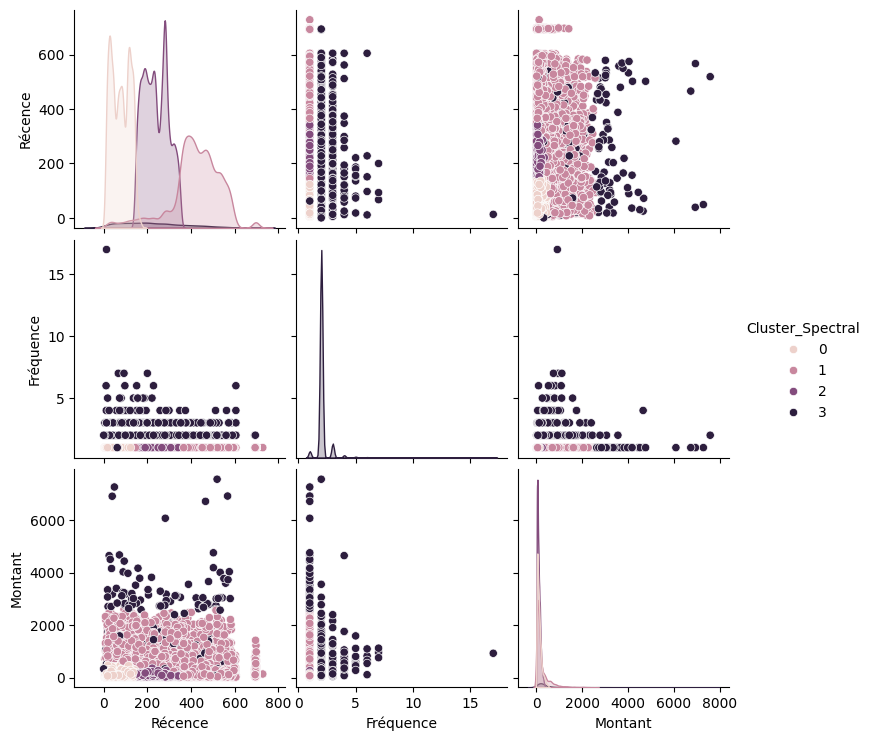

In [ ]:
# Calcul des moyennes pour chaque cluster
cluster_summary = data2.select_dtypes(include=[np.number]).groupby('Cluster_Spectral').mean()
print(cluster_summary)

# Pairplot avec coloration selon le cluster
sns.pairplot(data2, hue='Cluster_Spectral', vars=['Récence', 'Fréquence', 'Montant'])
plt.show()


## Cluster

In [ ]:
# Votre variable 'data_rfm_scaled_imputed' contient les données standardisées et imputées
# Votre DataFrame 'data2' contient maintenant une colonne 'Cluster' avec les labels de cluster
silhouette_avg = silhouette_score(data_rfm_scaled_imputed, data2['Cluster_Spectral'])
print(f"Le score moyen de silhouette pour les clusters est : {silhouette_avg:.2f}")


Le score moyen de silhouette pour les clusters est : 0.35


In [ ]:
# Réduction de la dimensionnalité en 2 composantes pour une visualisation 2D
pca_2d = PCA(n_components=2)
pca_result_2d = pca_2d.fit_transform(data_rfm_scaled_imputed)

# Réduction de la dimensionnalité en 3 composantes pour une visualisation 3D
pca_3d = PCA(n_components=3)
pca_result_3d = pca_3d.fit_transform(data_rfm_scaled_imputed)


In [ ]:
# Visualisation 2D
fig_2d = px.scatter(
    x=pca_result_2d[:, 0], y=pca_result_2d[:, 1],
    color=data2['Cluster_Spectral'].astype(str),  # Assurez-vous que les étiquettes sont converties en chaînes de caractères pour la légende
    labels={'0': 'PC 1', '1': 'PC 2'}
)
fig_2d.update_layout(title="Visualisation 2D des clusters avec PCA")
fig_2d.show()

# Visualisation 3D
fig_3d = px.scatter_3d(
    x=pca_result_3d[:, 0], y=pca_result_3d[:, 1], z=pca_result_3d[:, 2],
    color=data2['Cluster_Spectral'].astype(str),
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig_3d.update_layout(title="Visualisation 3D des clusters avec PCA")
fig_3d.show()


In [ ]:
# Nombre de clusters
n_clusters = 4

# Exécuter le clustering spectral avec différentes initialisations
labels = []
for i in range(10):  # 10 exécutions différentes
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors',
                                  assign_labels='kmeans', random_state=i, n_init=10)
    labels.append(spectral.fit_predict(data_rfm_scaled_imputed))

# Évaluer la stabilité des clusters à l'initialisation
# Calculer la similarité de Jaccard pour chaque paire unique d'exécutions
jaccard_scores = []
for i in range(len(labels)):
    for j in range(i+1, len(labels)):
        score = jaccard_score(labels[i], labels[j], average='macro')
        jaccard_scores.append(score)

# Afficher la moyenne des scores de Jaccard
print(f'Moyenne des scores de Jaccard pour la stabilité des clusters : {np.mean(jaccard_scores)}')


KeyboardInterrupt: 

In [ ]:
# Définition de la grille de paramètres pour KMeans
param_grid = {'n_clusters': range(3, 5),  # par exemple de 2 à 9 clusters
              'init': ['k-means++', 'random'],
              'n_init': [10, 15, 20],
              'max_iter': [300, 600, 900]}

# Initialisation de la meilleure métrique et du meilleur modèle
best_score = -1
best_model = None
best_params = {}

# Grid search manuel
for params in ParameterGrid(param_grid):
    kmeans = KMeans(**params)
    kmeans.fit(data_rfm_scaled_imputed)
    # Calcul du score de silhouette
    score = silhouette_score(data_rfm_scaled_imputed, kmeans.labels_)

    # Mise à jour du meilleur score et des meilleurs paramètres
    if score > best_score:
        best_score = score
        best_model = kmeans
        best_params = params

# Affichage des meilleurs paramètres et du meilleur score
print(f'Meilleurs paramètres : {best_params}')
print(f'Meilleur score de silhouette : {best_score}')


KeyboardInterrupt: 

In [ ]:
def simuler_clustering(data, colonne_date, nombre_de_periodes, n_clusters):
    # Convertir la colonne de date en datetime et trier le DataFrame par cette colonne
    data[colonne_date] = pd.to_datetime(data[colonne_date])
    data = data.sort_values(by=colonne_date)

    # Trouver la date la plus récente dans le dataset
    date_max = data[colonne_date].max()

    # Définir la durée d'une période en jours
    duree_periode = (date_max - data[colonne_date].min()) / nombre_de_periodes

    # Initialiser la liste pour stocker les résultats de clustering
    resultats_clustering = []

    # Créer les périodes et effectuer le clustering pour chacune
    for i in range(nombre_de_periodes):
        # Calculer les limites de la période actuelle
        fin_periode = date_max - i * duree_periode
        debut_periode = date_max - (i + 1) * duree_periode

        # Sélectionner les données pour la période actuelle
        donnees_periode = data[(data[colonne_date] > debut_periode) & (data[colonne_date] <= fin_periode)]

        # Imputer les valeurs manquantes
        imputer = SimpleImputer(strategy='mean')
        donnees_periode = donnees_periode.copy()  # Faire une copie pour éviter les avertissements
        donnees_periode[rfm_columns] = imputer.fit_transform(donnees_periode[rfm_columns])

        # Appliquer le clustering K-Means si assez de données
        if len(donnees_periode) >= n_clusters:
            kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=10)
            donnees_periode['Cluster_Spectral'] = kmeans.fit_predict(donnees_periode[rfm_columns])

            # Ajouter les résultats au tableau
            resultats_clustering.append({
                'debut_periode': debut_periode,
                'fin_periode': fin_periode,
                'donnees': donnees_periode,
                'etiquettes': kmeans.labels_
            })

    return resultats_clustering

# Vos colonnes RFM pourraient avoir des noms différents
rfm_columns = ['Récence', 'Fréquence', 'Montant']


In [ ]:
resultats_clustering = simuler_clustering(data2, 'Date_Derniere_Commande', 4, 4) #vos_donnees, 'Date_Premier_Commande', 'Date_Dernière_Commande', nombre_de_periodes, nombre_de_clusters)

# Après avoir généré resultats_clustering avec la fonction simuler_clustering...
# Palette de couleurs personnalisée
couleurs_clusters = {'0': 'red', '1': 'blue', '2': 'green', '3': 'orange'}

# Boucle sur les résultats de clustering
for i, resultat in enumerate(resultats_clustering):
    donnees_periode = resultat['donnees'].copy()  # Utiliser .copy() pour éviter SettingWithCopyWarning
    clusters = resultat['etiquettes']

    # Imputez les valeurs manquantes
    imputer = SimpleImputer(strategy='mean')
    donnees_periode[rfm_columns] = imputer.fit_transform(donnees_periode[rfm_columns])

    # ACP pour réduction à 2 dimensions
    pca_2d = PCA(n_components=2)
    pca_result_2d = pca_2d.fit_transform(donnees_periode[rfm_columns])

    # ACP pour réduction à 3 dimensions
    pca_3d = PCA(n_components=3)
    pca_result_3d = pca_3d.fit_transform(donnees_periode[rfm_columns])

    # Conversion des étiquettes de cluster en chaînes de caractères pour la couleur
    donnees_periode['Cluster_Spectral'] = pd.Categorical(clusters).astype(str)

    # Visualisation 2D
    fig_2d = px.scatter(
        x=pca_result_2d[:, 0], y=pca_result_2d[:, 1],
        color=donnees_periode['Cluster_Spectral'],
        color_discrete_map=couleurs_clusters,  # Utilisation de la palette personnalisée
        title=f"Visualisation 2D des clusters avec PCA pour la période {i + 1}"
    )
    fig_2d.show()

    # Visualisation 3D
    fig_3d = px.scatter_3d(
        x=pca_result_3d[:, 0], y=pca_result_3d[:, 1], z=pca_result_3d[:, 2],
        color=donnees_periode['Cluster_Spectral'],
        color_discrete_map=couleurs_clusters,  # Utilisation de la palette personnalisée
        title=f"Visualisation 3D des clusters avec PCA pour la période {i + 1}"
    )
    fig_3d.show()


In [ ]:
# Palette de couleurs personnalisée
couleurs_clusters = {'0': 'red', '1': 'blue', '2': 'green', '3': 'orange'}

data_with_periods = pd.concat([r['donnees'] for r in resultats_clustering], ignore_index=True)

# Conversion de 'Date_Derniere_Commande' en période (mois) et en chaîne de caractères pour Plotly
cluster_summary['periode'] = pd.to_datetime(data2['Date_Derniere_Commande']).dt.to_period('M').astype(str)

# Calcul de la taille de chaque cluster par période
cluster_sizes = data2.groupby(['periode', 'Cluster_Spectral']).size().reset_index(name='taille')

# Pivoter les données pour obtenir une colonne par cluster
pivot_table = cluster_sizes.pivot(index='periode', columns='Cluster_Spectral', values='taille').fillna(0)

# Réinitialisation de l'index pour utiliser 'periode' comme une colonne normale
pivot_table = pivot_table.reset_index()

# Préparation des données pour le graphique linéaire
# Plotly a besoin de les avoir en format long
data_for_plot = pd.melt(pivot_table, id_vars='periode', var_name='Cluster_Spectral', value_name='Taille')

# Création du graphique linéaire avec Plotly
fig = px.line(data_for_plot, x='periode', y='Taille', color='Cluster_Spectral', color_discrete_map=couleurs_clusters,
              title='Évolution de la taille des clusters au fil du temps',
              labels={'periode': 'Période', 'Taille': 'Taille du Cluster_Spectral', 'Cluster_Spectral': 'Cluster_Spectral'})

# Affichage du graphique
fig.show()

In [ ]:
# Assurez-vous que 'Date_Derniere_Commande' est convertie en datetime si ce n'est pas déjà fait
data2['Date_Derniere_Commande'] = pd.to_datetime(data2['Date_Derniere_Commande'])

# Créez la colonne 'periode'
data2['periode'] = data2['Date_Derniere_Commande'].dt.to_period("M").astype(str)

# Vérifiez que la colonne 'periode' existe
print(data2['periode'].head())

# Sélectionnez les données numériques et la colonne 'periode'
data2_numeric_with_period = data2.select_dtypes(include=[np.number])
data2_numeric_with_period['periode'] = data2['periode']

# Vérifiez que 'periode' est dans le nouveau DataFrame
print(data2_numeric_with_period.head())

# Maintenant, effectuez le groupement
centroids = data2_numeric_with_period.groupby(['periode', 'Cluster_Spectral']).mean().reset_index()
print(centroids.head())


0    2018-05
1    2018-05
2    2017-03
3    2017-10
4    2017-11
Name: periode, dtype: object
   customer_zip_code_prefix  nbr_commande  Total_achat  Récence  Fréquence  \
0                      7787             1       141.90      115          1   
1                      6053             1        27.19      118          1   
2                     88115             1        86.22      541          1   
3                     66812             1        43.62      325          1   
4                     18040             1       196.89      292          1   

   Montant  Cluster  Cluster_Spectral  periode  
0   141.90        0                 0  2018-05  
1    27.19        0                 0  2018-05  
2    86.22        1                 1  2017-03  
3    43.62        1                 2  2017-10  
4   196.89        1                 2  2017-11  
   periode  Cluster_Spectral  customer_zip_code_prefix  nbr_commande  \
0  2016-09                 1              69309.000000      1.000000   

In [ ]:
# Préparation des données pour le graphique linéaire - prenons la moyenne de la 'Récence' pour cet exemple
centroids = centroids.pivot(index='periode', columns='Cluster_Spectral', values='Récence').fillna(0)

# Réinitialisation de l'index pour utiliser 'periode' comme une colonne normale
centroids = centroids.reset_index()

# Conversion des périodes en chaîne pour la compatibilité avec Plotly
centroids['periode'] = centroids['periode'].astype(str)

# Préparation des données pour Plotly - format long
data_for_plot = pd.melt(centroids, id_vars='periode', var_name='Cluster_Spectral', value_name='Centroïdité_Récence')

# Création du graphique linéaire avec Plotly
fig = px.line(data_for_plot, x='periode', y='Centroïdité_Récence', color='Cluster_Spectral',color_discrete_map=couleurs_clusters,
              title='Évolution de la centroïdité des clusters pour la Récence au fil du temps',
              labels={'periode': 'Période', 'Centroïdité_Récence': 'Centroïdité de la Récence', 'Cluster_Spectral': 'Cluster_Spectral'})

# Affichage du graphique
fig.show()


In [ ]:
# Calcul des centroïdes pour chaque cluster et chaque période
centroids = data2_numeric_with_period.groupby(['periode', 'Cluster_Spectral']).mean().reset_index()

# Conversion des périodes en chaînes pour la compatibilité avec Plotly
centroids['periode'] = centroids['periode'].astype(str)


# Créer une figure Plotly
fig = go.Figure()

# Palette de couleurs pour les clusters
colors = {
    0: ['red', 'darkred', 'lightcoral'],
    1: ['blue', 'darkblue', 'lightblue'],
    2: ['green', 'darkgreen', 'lightgreen'],
    3: ['purple', 'indigo', 'plum']
}

# Ajout des traces pour chaque attribut RFM de chaque cluster
for cluster in centroids['Cluster_Spectral'].unique():
    cluster_data = centroids[centroids['Cluster_Spectral'] == cluster]
    for attr in ['Récence', 'Fréquence', 'Montant']:
        fig.add_trace(go.Scatter(
            x=cluster_data['periode'],
            y=cluster_data[attr],
            mode='lines+markers',
            name=f'Cluster {cluster} - {attr}',
            # Assurez-vous d'avoir une palette de couleurs unique pour chaque attribut RFM
        ))

# Mise à jour du layout du graphique
fig.update_layout(
    title='Évolution des centroïdes des clusters pour la Récence, la Fréquence et le Montant au fil du temps',
    xaxis_title='Période',
    yaxis_title='Valeur du centroïde',
    legend_title='Cluster et Attributs RFM'
)

# Affichage du graphique
fig.show()

In [ ]:
# Pour chaque attribut RFM, effectuez le test K-S entre chaque paire de clusters
for attr in ['Récence', 'Fréquence', 'Montant']:
    print(f"Test K-S pour l'attribut: {attr}")
    for i in range(4):
        for j in range(i+1, 4):
            data_cluster_i = data2[data2['Cluster_Spectral'] == i][attr]
            data_cluster_j = data2[data2['Cluster_Spectral'] == j][attr]

            # Vérifiez si l'un des clusters est vide
            if len(data_cluster_i) == 0 or len(data_cluster_j) == 0:
                print(f"Cluster_Spectral {i} vs {j}: L'un des clusters est vide, donc le test K-S ne peut pas être effectué.")
                continue

            # Sinon, effectuez le test K-S
            ks_statistic, p_value = ks_2samp(data_cluster_i, data_cluster_j)
            print(f"Cluster_Spectral {i} vs {j}: KS Statistic = {ks_statistic}, P-Value = {p_value}")


Test K-S pour l'attribut: Récence
Cluster_Spectral 0 vs 1: KS Statistic = 0.9482424301256582, P-Value = 0.0
Cluster_Spectral 0 vs 2: KS Statistic = 0.9676901957421004, P-Value = 0.0
Cluster_Spectral 0 vs 3: KS Statistic = 0.6383838560520793, P-Value = 0.0
Cluster_Spectral 1 vs 2: KS Statistic = 0.8205952465191343, P-Value = 0.0
Cluster_Spectral 1 vs 3: KS Statistic = 0.6042054227936894, P-Value = 0.0
Cluster_Spectral 2 vs 3: KS Statistic = 0.33008957807524425, P-Value = 7.313783078413256e-251
Test K-S pour l'attribut: Fréquence
Cluster_Spectral 0 vs 1: KS Statistic = 0.0, P-Value = 1.0
Cluster_Spectral 0 vs 2: KS Statistic = 0.0, P-Value = 1.0
Cluster_Spectral 0 vs 3: KS Statistic = 0.97264218862491, P-Value = 0.0
Cluster_Spectral 1 vs 2: KS Statistic = 0.0, P-Value = 1.0
Cluster_Spectral 1 vs 3: KS Statistic = 0.97264218862491, P-Value = 0.0
Cluster_Spectral 2 vs 3: KS Statistic = 0.97264218862491, P-Value = 0.0
Test K-S pour l'attribut: Montant
Cluster_Spectral 0 vs 1: KS Statistic =

# DBSCAN et AggloClustering (Non-Utilisé)

In [ ]:
# from sklearn.cluster import DBSCAN

# Création de l'instance DBSCAN
# eps est la distance maximale entre deux échantillons pour qu'ils soient considérés comme dans le même voisinage
# min_samples est le nombre de points minimum requis pour former un cluster dense

# dbscan = DBSCAN(eps=1, min_samples=10)

# Fit du modèle sur les données standardisées
# clusters = dbscan.fit_predict(data_rfm_scaled_imputed)

# Ajouter les étiquettes de cluster au DataFrame
# data2['Cluster_DBSCAN'] = clusters

In [ ]:
# from sklearn.cluster import AgglomerativeClustering

# Création de l'instance AgglomerativeClustering
# n_clusters est le nombre de clusters à trouver
# linkage détermine le critère de liaison à utiliser

# agglo = AgglomerativeClustering(n_clusters=4, linkage='ward')

# Fit du modèle sur les données standardisées
# clusters = agglo.fit_predict(data_rfm_scaled_imputed)

# Ajouter les étiquettes de cluster au DataFrame
# data2['Cluster_Hierarchique'] = clusters
